# Jamie's Notebook - Phase 3 Project

## Project Requirements:

Problem First: Start with a problem that you are interested in that you could potentially solve with a classification model. Then look for data that you could use to solve that problem. This approach is high-risk, high-reward: Very rewarding if you are able to solve a problem you are invested in, but frustrating if you end up sinking lots of time in without finding appropriate data. To mitigate the risk, set a firm limit for the amount of time you will allow yourself to look for data before moving on to the Data First approach.

Data First: Take a look at some of the most popular internet repositories of cool data sets we've listed below. If you find a data set that's particularly interesting for you, then it's totally okay to build your problem around that data set.

### Car Crash data:

Build a classifier to predict the primary contributory cause of a car accident, given information about the car, the people in the car, the road conditions etc. You might imagine your audience as a Vehicle Safety Board who's interested in reducing traffic accidents, or as the City of Chicago who's interested in becoming aware of any interesting patterns. Note that there is a multi-class classification problem. You will almost certainly want to bin or trim or otherwise limit the number of target categories on which you ultimately predict. Note e.g. that some primary contributory causes have very few samples.

### Stakeholder
> ?

### Business Problem
> ?

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# EDA

Crash data shows information about each traffic crash on city streets within the **City of Chicago** limits and under the jurisdiction of Chicago Police Department (CPD). Data are shown as is from the electronic crash reporting system (E-Crash) at CPD, excluding any personally identifiable information. Records are added to the data portal when a crash report is finalized or when amendments are made to an existing report in E-Crash. Data from E-Crash are available for some police districts in 2015, but citywide data are not available until September 2017. About half of all crash reports, mostly minor crashes, are self-reported at the police district by the driver(s) involved and the other half are recorded at the scene by the police officer responding to the crash. Many of the crash parameters, including street condition data, weather condition, and posted speed limits, are recorded by the reporting officer based on best available information at the time, but many of these may disagree with posted information or other assessments on road conditions. If any new or updated information on a crash is received, the reporting officer may amend the crash report at a later time. A traffic crash within the city limits for which CPD is not the responding police agency, typically crashes on interstate highways, freeway ramps, and on local roads along the City boundary, are excluded from this dataset.

All crashes are recorded as per the format specified in the Traffic Crash Report, SR1050, of the Illinois Department of Transportation. **As per Illinois statute, only crashes with a property damage value of *1,500 or more* or involving bodily injury to any person(s) and that happen on a public roadway and that involve at least one moving vehicle, except bike dooring, are considered reportable crashes.** However, CPD records every reported traffic crash event, regardless of the statute of limitations, and hence any formal Chicago crash dataset released by Illinois Department of Transportation may not include all the crashes listed here.

In [2]:
# read in file
# Source: https://data.cityofchicago.org/Transportation/Traffic-Crashes-Crashes/85ca-t3if 
data = pd.read_csv('traffic_crashes_chicago.csv')

In [3]:
data.head()

,CRASH_RECORD_ID,RD_NO,CRASH_DATE_EST_I,CRASH_DATE,POSTED_SPEED_LIMIT,TRAFFIC_CONTROL_DEVICE,DEVICE_CONDITION,WEATHER_CONDITION,LIGHTING_CONDITION,FIRST_CRASH_TYPE,...,INJURIES_NON_INCAPACITATING,INJURIES_REPORTED_NOT_EVIDENT,INJURIES_NO_INDICATION,INJURIES_UNKNOWN,CRASH_HOUR,CRASH_DAY_OF_WEEK,CRASH_MONTH,LATITUDE,LONGITUDE,LOCATION
0,4fd0a3e0897b3335b94cd8d5b2d2b350eb691add56c62d...,JC343143,NaN,07/10/2019 05:56:00 PM,35,NO CONTROLS,NO CONTROLS,CLEAR,DAYLIGHT,TURNING,...,0.0,0.0,3.0,0.0,17,4,7,41.919664,-87.773288,POINT (-87.773287883007 41.919663832993)
1,009e9e67203442370272e1a13d6ee51a4155dac65e583d...,JA329216,NaN,06/30/2017 04:00:00 PM,35,STOP SIGN/FLASHER,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,TURNING,...,0.0,0.0,3.0,0.0,16,6,6,41.741804,-87.740954,POINT (-87.740953581987 41.741803598989)
2,ee9283eff3a55ac50ee58f3d9528ce1d689b1c4180b4c4...,JD292400,NaN,07/10/2020 10:25:00 AM,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,REAR END,...,0.0,0.0,3.0,0.0,10,6,7,41.773456,-87.585022,POINT (-87.585022352022 41.773455972008)
3,f8960f698e870ebdc60b521b2a141a5395556bc3704191...,JD293602,NaN,07/11/2020 01:00:00 AM,30,NO CONTROLS,NO CONTROLS,CLEAR,DARKNESS,PARKED MOTOR VEHICLE,...,0.0,0.0,3.0,0.0,1,7,7,41.802119,-87.622115,POINT (-87.622114914961 41.802118543011)
4,8eaa2678d1a127804ee9b8c35ddf7d63d913c14eda61d6...,JD290451,NaN,07/08/2020 02:00:00 PM,20,NO CONTROLS,NO CONTROLS,CLEAR,DAYLIGHT,PARKED MOTOR VEHICLE,...,0.0,0.0,1.0,0.0,14,4,7,NaN,NaN,NaN


In [4]:
def basic_info(data):
    print("Dataset shape is: ", data.shape)
    print("Dataset size is: ", data.size)
    print("Dataset columns are: ", data.columns)
    print("Dataset info is: ", data.info())
    categorical = []
    numerical = []
    for i in data.columns:
        if data[i].dtype == object:
            categorical.append(i)
        else:
            numerical.append(i)
    print("Categorical variables are:\n ", categorical)
    print("Numerical variables are:\n ", numerical)
    return categorical, numerical

In [5]:
len(data)

483078

In [6]:
data.LATITUDE

0         41.919664
1         41.741804
2         41.773456
3         41.802119
4               NaN
            ...    
483073    41.877790
483074    41.800697
483075    41.924709
483076    41.802871
483077    41.953010
Name: LATITUDE, Length: 483078, dtype: float64

In [7]:
data.CRASH_DATE_EST_I.value_counts()

Y    31529
N     4752
Name: CRASH_DATE_EST_I, dtype: int64

In [8]:
data.isna().sum() 

CRASH_RECORD_ID                       0
RD_NO                              3836
CRASH_DATE_EST_I                 446797
CRASH_DATE                            0
POSTED_SPEED_LIMIT                    0
TRAFFIC_CONTROL_DEVICE                0
DEVICE_CONDITION                      0
WEATHER_CONDITION                     0
LIGHTING_CONDITION                    0
FIRST_CRASH_TYPE                      0
TRAFFICWAY_TYPE                       0
LANE_CNT                         284114
ALIGNMENT                             0
ROADWAY_SURFACE_COND                  0
ROAD_DEFECT                           0
REPORT_TYPE                       11749
CRASH_TYPE                            0
INTERSECTION_RELATED_I           374083
NOT_RIGHT_OF_WAY_I               460357
HIT_AND_RUN_I                    341059
DAMAGE                                0
DATE_POLICE_NOTIFIED                  0
PRIM_CONTRIBUTORY_CAUSE               0
SEC_CONTRIBUTORY_CAUSE                0
STREET_NO                             0


In [9]:
data_fsm = data.fillna(value=0)

In [10]:
len(data_fsm)

483078

In [11]:
lots_o_missing = ['CRASH_RECORD_ID', 'dead?']
for col in data_fsm.columns:
    if len(data_fsm[col][data_fsm[col]==0]) > 300000:
        lots_o_missing.append(col)
lots_o_missing

['CRASH_RECORD_ID',
 'dead?',
 'CRASH_DATE_EST_I',
 'INTERSECTION_RELATED_I',
 'NOT_RIGHT_OF_WAY_I',
 'HIT_AND_RUN_I',
 'PHOTOS_TAKEN_I',
 'STATEMENTS_TAKEN_I',
 'DOORING_I',
 'WORK_ZONE_I',
 'WORK_ZONE_TYPE',
 'WORKERS_PRESENT_I',
 'INJURIES_TOTAL',
 'INJURIES_FATAL',
 'INJURIES_INCAPACITATING',
 'INJURIES_NON_INCAPACITATING',
 'INJURIES_REPORTED_NOT_EVIDENT',
 'INJURIES_UNKNOWN']

In [12]:
data_fsm['dead?'] = np.where(data_fsm['INJURIES_FATAL']>0, 1, 0)
data_fsm.head()

,CRASH_RECORD_ID,RD_NO,CRASH_DATE_EST_I,CRASH_DATE,POSTED_SPEED_LIMIT,TRAFFIC_CONTROL_DEVICE,DEVICE_CONDITION,WEATHER_CONDITION,LIGHTING_CONDITION,FIRST_CRASH_TYPE,...,INJURIES_REPORTED_NOT_EVIDENT,INJURIES_NO_INDICATION,INJURIES_UNKNOWN,CRASH_HOUR,CRASH_DAY_OF_WEEK,CRASH_MONTH,LATITUDE,LONGITUDE,LOCATION,dead?
0,4fd0a3e0897b3335b94cd8d5b2d2b350eb691add56c62d...,JC343143,0,07/10/2019 05:56:00 PM,35,NO CONTROLS,NO CONTROLS,CLEAR,DAYLIGHT,TURNING,...,0.0,3.0,0.0,17,4,7,41.919664,-87.773288,POINT (-87.773287883007 41.919663832993),0
1,009e9e67203442370272e1a13d6ee51a4155dac65e583d...,JA329216,0,06/30/2017 04:00:00 PM,35,STOP SIGN/FLASHER,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,TURNING,...,0.0,3.0,0.0,16,6,6,41.741804,-87.740954,POINT (-87.740953581987 41.741803598989),0
2,ee9283eff3a55ac50ee58f3d9528ce1d689b1c4180b4c4...,JD292400,0,07/10/2020 10:25:00 AM,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,REAR END,...,0.0,3.0,0.0,10,6,7,41.773456,-87.585022,POINT (-87.585022352022 41.773455972008),0
3,f8960f698e870ebdc60b521b2a141a5395556bc3704191...,JD293602,0,07/11/2020 01:00:00 AM,30,NO CONTROLS,NO CONTROLS,CLEAR,DARKNESS,PARKED MOTOR VEHICLE,...,0.0,3.0,0.0,1,7,7,41.802119,-87.622115,POINT (-87.622114914961 41.802118543011),0
4,8eaa2678d1a127804ee9b8c35ddf7d63d913c14eda61d6...,JD290451,0,07/08/2020 02:00:00 PM,20,NO CONTROLS,NO CONTROLS,CLEAR,DAYLIGHT,PARKED MOTOR VEHICLE,...,0.0,1.0,0.0,14,4,7,0.000000,0.000000,0,0


In [13]:
from sklearn.linear_model import LogisticRegression
X = data_fsm.drop(labels=lots_o_missing, axis=1).select_dtypes(exclude='object')
y = data_fsm['dead?']
lr = LogisticRegression()
lr.fit(X, y)


C:\Users\Chris\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [14]:
lr.__dict__

{'penalty': 'l2',
 'dual': False,
 'tol': 0.0001,
 'C': 1.0,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'class_weight': None,
 'random_state': None,
 'solver': 'lbfgs',
 'max_iter': 100,
 'multi_class': 'auto',
 'verbose': 0,
 'warm_start': False,
 'n_jobs': None,
 'l1_ratio': None,
 'n_features_in_': 11,
 'classes_': array([0, 1]),
 'coef_': array([[-4.33648510e-02, -2.10097333e-04, -1.35849426e-05,
         -7.54570109e-04, -2.07888584e-02, -8.66188898e-02,
         -8.49510876e-02, -4.64375745e-02, -4.72300502e-02,
         -1.47214614e-02,  2.92443586e-02]]),
 'intercept_': array([-0.01257961]),
 'n_iter_': array([100])}

In [15]:
lr.score(X, y)

0.9990229321144826

In [16]:
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier, plot_tree 
dt = DecisionTreeClassifier()
dt.fit(X, y)
dt.score(X, y)

1.0

In [17]:
data_fsm.head()

,CRASH_RECORD_ID,RD_NO,CRASH_DATE_EST_I,CRASH_DATE,POSTED_SPEED_LIMIT,TRAFFIC_CONTROL_DEVICE,DEVICE_CONDITION,WEATHER_CONDITION,LIGHTING_CONDITION,FIRST_CRASH_TYPE,...,INJURIES_REPORTED_NOT_EVIDENT,INJURIES_NO_INDICATION,INJURIES_UNKNOWN,CRASH_HOUR,CRASH_DAY_OF_WEEK,CRASH_MONTH,LATITUDE,LONGITUDE,LOCATION,dead?
0,4fd0a3e0897b3335b94cd8d5b2d2b350eb691add56c62d...,JC343143,0,07/10/2019 05:56:00 PM,35,NO CONTROLS,NO CONTROLS,CLEAR,DAYLIGHT,TURNING,...,0.0,3.0,0.0,17,4,7,41.919664,-87.773288,POINT (-87.773287883007 41.919663832993),0
1,009e9e67203442370272e1a13d6ee51a4155dac65e583d...,JA329216,0,06/30/2017 04:00:00 PM,35,STOP SIGN/FLASHER,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,TURNING,...,0.0,3.0,0.0,16,6,6,41.741804,-87.740954,POINT (-87.740953581987 41.741803598989),0
2,ee9283eff3a55ac50ee58f3d9528ce1d689b1c4180b4c4...,JD292400,0,07/10/2020 10:25:00 AM,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,REAR END,...,0.0,3.0,0.0,10,6,7,41.773456,-87.585022,POINT (-87.585022352022 41.773455972008),0
3,f8960f698e870ebdc60b521b2a141a5395556bc3704191...,JD293602,0,07/11/2020 01:00:00 AM,30,NO CONTROLS,NO CONTROLS,CLEAR,DARKNESS,PARKED MOTOR VEHICLE,...,0.0,3.0,0.0,1,7,7,41.802119,-87.622115,POINT (-87.622114914961 41.802118543011),0
4,8eaa2678d1a127804ee9b8c35ddf7d63d913c14eda61d6...,JD290451,0,07/08/2020 02:00:00 PM,20,NO CONTROLS,NO CONTROLS,CLEAR,DAYLIGHT,PARKED MOTOR VEHICLE,...,0.0,1.0,0.0,14,4,7,0.000000,0.000000,0,0


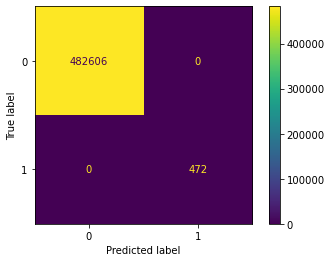

In [18]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(dt, X, y)

In [19]:
dt.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [20]:
!pip install imblearn

In [21]:

from imblearn.over_sampling import SMOTE
smote = SMOTE()
X_resampled, y_resampled = smote.fit_sample(X, y)


In [22]:
data.columns = [data.columns[i].lower() for i in range(len(data.columns))]

In [23]:
data.iloc[111].crash_date

'04/30/2018 03:07:00 PM'

In [24]:
data['month'] = data['crash_date'].apply(lambda x: int(x[:2]))
data['day'] = data['crash_date'].apply(lambda x: int(x[3:5]))
data['year'] = data['crash_date'].apply(lambda x: int(x[6:10]))
data['time_of_crash'] = data['crash_date'].apply(
    lambda x: int(x[11:13]+x[14:16]+x[17:19]) if 'AM' in x else int((str(int(x[11:13])+12))+x[14:16]+x[17:19])
)
data['time_of_crash'].iloc[111]




150700

In [25]:
data.crash_date.dtype

dtype('O')

In [26]:
data.columns

Index(['crash_record_id', 'rd_no', 'crash_date_est_i', 'crash_date',
       'posted_speed_limit', 'traffic_control_device', 'device_condition',
       'weather_condition', 'lighting_condition', 'first_crash_type',
       'trafficway_type', 'lane_cnt', 'alignment', 'roadway_surface_cond',
       'road_defect', 'report_type', 'crash_type', 'intersection_related_i',
       'not_right_of_way_i', 'hit_and_run_i', 'damage', 'date_police_notified',
       'prim_contributory_cause', 'sec_contributory_cause', 'street_no',
       'street_direction', 'street_name', 'beat_of_occurrence',
       'photos_taken_i', 'statements_taken_i', 'dooring_i', 'work_zone_i',
       'work_zone_type', 'workers_present_i', 'num_units',
       'most_severe_injury', 'injuries_total', 'injuries_fatal',
       'injuries_incapacitating', 'injuries_non_incapacitating',
       'injuries_reported_not_evident', 'injuries_no_indication',
       'injuries_unknown', 'crash_hour', 'crash_day_of_week', 'crash_month',
       'la

# Visualizations

## GeoPandas

##### Sources:

https://data.cityofchicago.org/browse?tags=gis

In [27]:
# import geopandas as gpd

# chitown = gpd.read_file('data/Public_Expressway_Crash_Rates_2008_2012.shp')

In [28]:
# data.street_name.value_counts(sort=True)

In [29]:
# Top 5 Crash streets
# fig, ax = plt.subplots(figsize=(10,6))

# street_names = data.street_name.value_counts(sort=True).index[:10]
# crash_frequency = data.street_name.value_counts(sort=True).values[:10]

# ax.bar(street_names, crash_frequency)
# ax.set_title('Top 10 Crash Sites (Street Names), Chicago IL', size=15)
# ax.set_xticklabels(street_names, rotation=45)

In [30]:
# chi1998.head()

In [31]:
# data.latitude.value_counts()

In [32]:
# data.longitude.dtype

In [33]:
# locations = data[['latitude', 'longitude']].dropna()
# chiboundaries = gpd.read_file('data/chipoli.shp')

# fig, ax = plt.subplots(figsize=(15,15))

# chiboundaries.plot(ax=ax)

In [34]:
# locations = data[data['latitude']!=0]
# locations

In [35]:
# len(locations[locations.longitude==0])

In [36]:
# len(locations[locations.latitude==0])

In [37]:
# locations.longitude.max()

In [38]:
# chi1998 = gpd.read_file('data/ward1998.shp')
# fig, ax = plt.subplots(figsize=(15,15))

# chi1998.plot(ax=ax, color='rebeccapurple')
# ax.scatter(locations['longitude'][(locations['most_severe_injury']=='INCAPACITATING INJURY')|(locations['most_severe_injury']=='FATAL')],
#            locations['latitude'][(locations['most_severe_injury']=='INCAPACITATING INJURY')|(locations['most_severe_injury']=='FATAL')])
# ax.set_title('Location of Incapacitating or Fatal Injuries - Car Crashes in Chicago, IL', size=15)

In [39]:
# fig, ax = plt.subplots(figsize=(15,15))

# chi1998.plot(ax=ax, color='rebeccapurple')
# ax.scatter(locations['longitude'][locations['most_severe_injury']=='FATAL'],
#            locations['latitude'][locations['most_severe_injury']=='FATAL'])
# ax.set_title('Location of Fatal Injuries - Car Crashes in Chicago, IL', size=15)

In [40]:
# Plot cloropleth showing population density - perhaps denser areas have 
# a higher indidence of crashes
# fig, ax = plt.subplots(figsize=(15,15))
# chi1998.plot(ax=ax, color='rebeccapurple')

In [41]:
# Plot crime rate cloropleth - see if there is a higher indidence of crashes
# in more dangerous areas
# fig, ax = plt.subplots(figsize=(15,15))
# chi1998.plot(ax=ax, color='rebeccapurple')

## Folium

In [42]:
import folium
from folium import plugins

In [43]:
chimap = folium.Map(location=[41.878876, -87.635918],
                    zoom_start = 12,
                    control_scale=True,
                   tiles = "OpenStreetMap")

folium.raster_layers.TileLayer('Open Street Map').add_to(chimap)
folium.raster_layers.TileLayer('Stamen Toner').add_to(chimap)
folium.raster_layers.TileLayer('Stamen Watercolor').add_to(chimap)
folium.raster_layers.TileLayer('CartoDB Positron').add_to(chimap)
folium.raster_layers.TileLayer('CartoDB Dark_Matter').add_to(chimap)
folium.raster_layers.TileLayer('Stamen Terrain').add_to(chimap)


# folium.LayerControl().add_to(chimap)

minimap = plugins.MiniMap(toggle_display=True)
chimap.add_child(minimap)

plugins.Fullscreen(position='topright').add_to(chimap)

draw = plugins.Draw(export=True)
draw.add_to(chimap)
display(chimap)

In [44]:
# zipmap = folium.Map(location=[41.878876, -87.635918],
#                      zoom_start = 10)
# zipcodes = "https://data.cityofchicago.org/api/geospatial/gdcf-axmw?method=export&format=GeoJSON"
# folium.GeoJson(zipcodes, name="Chicago Zipcodes").add_to(zipmap)
# dataheat['lighting_condition'].value_counts()

In [45]:
dataheat = data.dropna(subset = ['latitude'])

dataheatdaylight = dataheat[dataheat['weather_condition'] == 'DAYLIGHT']
dataheatdarknesslight = dataheat[dataheat['weather_condition'] == 'DARKNESS, LIGHTED ROAD']
dataheatdarkness = dataheat[dataheat['weather_condition'] == 'DARKNESS']
dataheatunknown = dataheat[dataheat['weather_condition'] == 'UNKNOWN']
dataheatdusk = dataheat[dataheat['weather_condition'] == 'DUSK']
dataheatdawn = dataheat[dataheat['weather_condition'] == 'DAWN']

In [46]:
folium.plugins.HeatMap(list(zip(dataheat['latitude'], dataheat['longitude'])), radius=2, blur=3).add_to(chimap)
folium.LayerControl().add_to(chimap)
display(chimap)

In [47]:
chimapdaylight = folium.Map(location=[41.878876, -87.635918],
                    zoom_start = 12,
                    control_scale=True,
                   tiles = "OpenStreetMap")

folium.plugins.HeatMap(list(zip(dataheatdaylight['latitude'], dataheatdaylight['longitude'])), radius=2, blur=3).add_to(chimapdaylight)
folium.LayerControl().add_to(chimapdaylight)
display(chimapdaylight)

In [48]:
chimapdarknesslight = folium.Map(location=[41.878876, -87.635918],
                    zoom_start = 12,
                    control_scale=True,
                   tiles = "OpenStreetMap")

folium.plugins.HeatMap(list(zip(dataheatdarknesslight['latitude'], dataheatdarknesslight['longitude'])), radius=2, blur=3).add_to(chimapdarknesslight)
folium.LayerControl().add_to(chimapdarknesslight)
display(chimapdarknesslight)

In [49]:
chimapdarkness = folium.Map(location=[41.878876, -87.635918],
                    zoom_start = 12,
                    control_scale=True,
                   tiles = "OpenStreetMap")

folium.plugins.HeatMap(list(zip(dataheatdarkness['latitude'], dataheatdarkness['longitude'])), radius=2, blur=3).add_to(chimapdarkness)
folium.LayerControl().add_to(chimapdarkness)
display(chimapdarkness)

In [50]:
chimapunknown = folium.Map(location=[41.878876, -87.635918],
                    zoom_start = 12,
                    control_scale=True,
                   tiles = "OpenStreetMap")

folium.plugins.HeatMap(list(zip(dataheatunknown['latitude'], dataheatunknown['longitude'])), radius=2, blur=3).add_to(chimapunknown)
folium.LayerControl().add_to(chimapunknown)
display(chimapunknown)

In [51]:
chimapdusk = folium.Map(location=[41.878876, -87.635918],
                    zoom_start = 12,
                    control_scale=True,
                   tiles = "OpenStreetMap")

folium.plugins.HeatMap(list(zip(dataheatdusk['latitude'], dataheatdusk['longitude'])), radius=2, blur=3).add_to(chimapdusk)
folium.LayerControl().add_to(chimapdusk)
display(chimapdusk)

In [52]:
chimapdawn = folium.Map(location=[41.878876, -87.635918],
                    zoom_start = 12,
                    control_scale=True,
                   tiles = "OpenStreetMap")

folium.plugins.HeatMap(list(zip(dataheatdawn['latitude'], dataheatdawn['longitude'])), radius=2, blur=3).add_to(chimapdawn)
folium.LayerControl().add_to(chimapdawn)
display(chimapdawn)

## MatPlotLib

<ipython-input-53-57e54a7f51e6>:9: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(weather_conditions, rotation=45)


[Text(0, 0, 'CLEAR'),
 Text(1, 0, 'RAIN'),
 Text(2, 0, 'UNKNOWN'),
 Text(3, 0, 'SNOW'),
 Text(4, 0, 'CLOUDY/OVERCAST'),
 Text(5, 0, 'OTHER'),
 Text(6, 0, 'FOG/SMOKE/HAZE'),
 Text(7, 0, 'SLEET/HAIL'),
 Text(8, 0, 'FREEZING RAIN/DRIZZLE'),
 Text(9, 0, 'BLOWING SNOW'),
 Text(10, 0, 'SEVERE CROSS WIND GATE'),
 Text(11, 0, 'BLOWING SAND, SOIL, DIRT')]

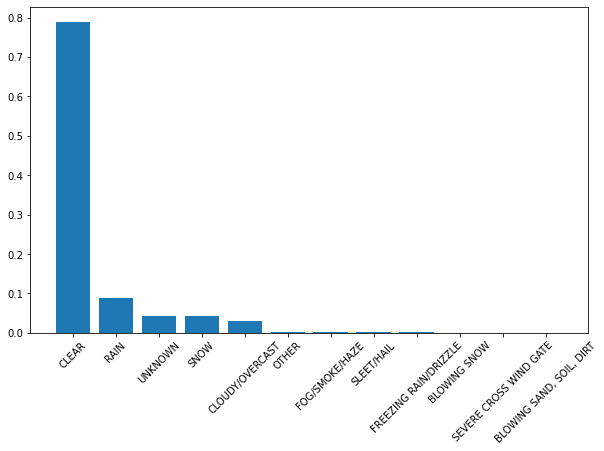

In [53]:
# comparing crash frequency and weather condition

fig, ax = plt.subplots(figsize=(10,6))

weather_conditions = data.weather_condition.value_counts(sort=True).index
weather_frequencies = data.weather_condition.value_counts(sort=True, normalize=True).values

ax.bar(weather_conditions, weather_frequencies)
ax.set_xticklabels(weather_conditions, rotation=45)

In [54]:
data.road_defect.value_counts(sort=True).index

Index(['NO DEFECTS', 'UNKNOWN', 'RUT, HOLES', 'OTHER', 'WORN SURFACE',
       'SHOULDER DEFECT', 'DEBRIS ON ROADWAY'],
      dtype='object')

Text(0.5, 1.0, 'types of road defects')

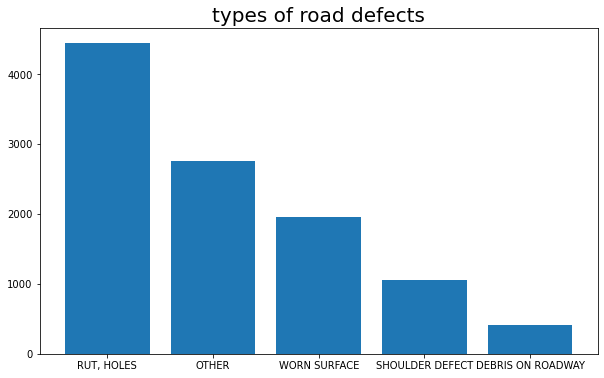

In [55]:
fig, ax = plt.subplots(figsize=(10,6))

defect_types = data.road_defect.value_counts(sort=True).index[2:]

frequency = data.road_defect.value_counts(sort=True).values[2:]

ax.bar(defect_types, frequency)
ax.set_title('types of road defects', size=20)

In [56]:
data.most_severe_injury.value_counts()

NO INDICATION OF INJURY     420186
NONINCAPACITATING INJURY     34268
REPORTED, NOT EVIDENT        19329
INCAPACITATING INJURY         7845
FATAL                          472
Name: most_severe_injury, dtype: int64

Text(0.5, 1.0, 'Number of Crashes with INCAPACITATING or FATAL Injuries sorted by Time of Day')

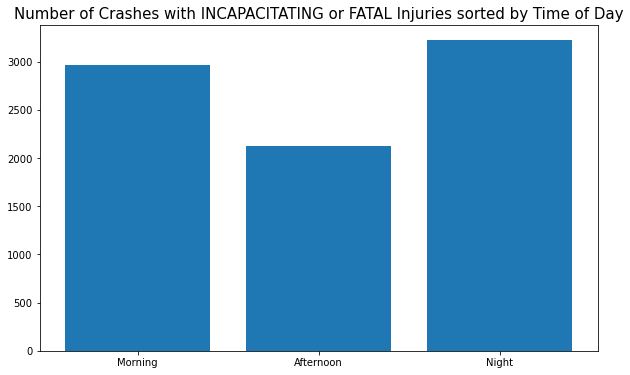

In [57]:
# Comparing distribution of incapacitating/fatal injuries and time of day
fig, ax = plt.subplots(figsize=(10,6))
crash_times = ['Morning', 'Afternoon', 'Night']
crash_counts_injuries = [
               len(data[(data['time_of_crash']<120000)&((data['most_severe_injury']=='INCAPACITATING INJURY')|(data['most_severe_injury']=='FATAL'))]),
               len(data[(data['time_of_crash']>=120000)&(data['time_of_crash']<170000)&((data['most_severe_injury']=='INCAPACITATING INJURY')|(data['most_severe_injury']=='FATAL'))]),
               len(data[(data['time_of_crash']>=170000)&((data['most_severe_injury']=='INCAPACITATING INJURY')|(data['most_severe_injury']=='FATAL'))])
               ]

ax.bar(crash_times, crash_counts_injuries)
ax.set_title('Number of Crashes with INCAPACITATING or FATAL Injuries sorted by Time of Day', size=15)

Text(0.5, 1.0, 'Number of Crashes based on Time of Day, Chicago, IL')

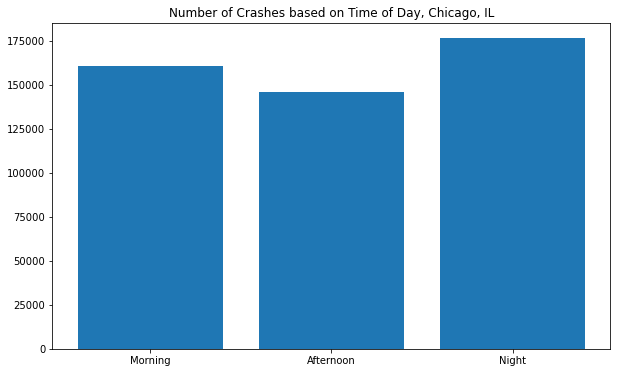

In [58]:
# Comparing distribution of crash times
fig, ax = plt.subplots(figsize=(10,6))
crash_times = ['Morning', 'Afternoon', 'Night']
crash_counts = [
               len(data['time_of_crash'][data['time_of_crash']<120000]),
               len(data['time_of_crash'][(data['time_of_crash']>=120000)&(data['time_of_crash']<170000)]),
               len(data['time_of_crash'][(data['time_of_crash']>=170000)])
               ]
ax.bar(crash_times, crash_counts)
ax.set_title('Number of Crashes based on Time of Day, Chicago, IL')

In [59]:
data.prim_contributory_cause.value_counts()

UNABLE TO DETERMINE                                                                 178640
FAILING TO YIELD RIGHT-OF-WAY                                                        53142
FOLLOWING TOO CLOSELY                                                                51342
NOT APPLICABLE                                                                       25926
IMPROPER OVERTAKING/PASSING                                                          22919
IMPROPER BACKING                                                                     21151
FAILING TO REDUCE SPEED TO AVOID CRASH                                               20802
IMPROPER LANE USAGE                                                                  18683
IMPROPER TURNING/NO SIGNAL                                                           16029
DRIVING SKILLS/KNOWLEDGE/EXPERIENCE                                                  15021
DISREGARDING TRAFFIC SIGNALS                                                          8748

<ipython-input-60-9142836e6fc8>:8: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(causes, rotation=90)


[Text(0, 0, 'UNABLE TO DETERMINE'),
 Text(1, 0, 'FAILING TO YIELD RIGHT-OF-WAY'),
 Text(2, 0, 'FOLLOWING TOO CLOSELY'),
 Text(3, 0, 'NOT APPLICABLE'),
 Text(4, 0, 'IMPROPER OVERTAKING/PASSING'),
 Text(5, 0, 'IMPROPER BACKING'),
 Text(6, 0, 'FAILING TO REDUCE SPEED TO AVOID CRASH'),
 Text(7, 0, 'IMPROPER LANE USAGE'),
 Text(8, 0, 'IMPROPER TURNING/NO SIGNAL'),
 Text(9, 0, 'DRIVING SKILLS/KNOWLEDGE/EXPERIENCE')]

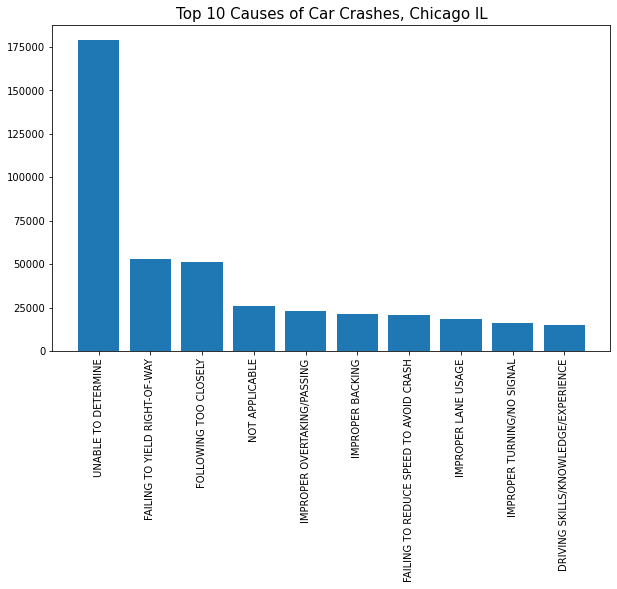

In [60]:
# Top 10 primary causes of car crashes
fig, ax = plt.subplots(figsize=(10,6))
causes = data.prim_contributory_cause.value_counts(sort=True).index[:10]
cause_freq = data.prim_contributory_cause.value_counts(sort=True).values[:10]

ax.bar(causes, cause_freq)
ax.set_title('Top 10 Causes of Car Crashes, Chicago IL', size=15)
ax.set_xticklabels(causes, rotation=90)

In [61]:
data.injuries_incapacitating.value_counts()

0.0    474193
1.0      6937
2.0       726
3.0       174
4.0        62
5.0        15
6.0         3
7.0         1
Name: injuries_incapacitating, dtype: int64

In [62]:
data.injuries_fatal.value_counts()

0.0    481639
1.0       438
2.0        28
3.0         5
4.0         1
Name: injuries_fatal, dtype: int64

In [63]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 483078 entries, 0 to 483077
Data columns (total 53 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   crash_record_id                483078 non-null  object 
 1   rd_no                          479242 non-null  object 
 2   crash_date_est_i               36281 non-null   object 
 3   crash_date                     483078 non-null  object 
 4   posted_speed_limit             483078 non-null  int64  
 5   traffic_control_device         483078 non-null  object 
 6   device_condition               483078 non-null  object 
 7   weather_condition              483078 non-null  object 
 8   lighting_condition             483078 non-null  object 
 9   first_crash_type               483078 non-null  object 
 10  trafficway_type                483078 non-null  object 
 11  lane_cnt                       198964 non-null  float64
 12  alignment                     

## Models